Note: Followed DCGAN Tutorial by Nathan Inkawhich:
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

# Imports

In [ ]:
# You need to mount your google drive in order to load the data:
from google.colab import drive
drive.mount('/content/drive')
# Put all the corresponding data files in a data folder and put the data folder in a same directory with this notebook.
# Also create an output directory for your files such as the trained models and the output images.

Mounted at /content/drive


In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
from torch.utils.data import Dataset, DataLoader
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image, ImageDraw



# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

BASE_DIR = '/content/drive/My Drive/DCGAN'
data_dirs = '{}/data'.format(BASE_DIR)

Random Seed:  999


In [ ]:
# import zipfile
# with zipfile.ZipFile(f'{BASE_DIR}/img_align_celeba.zip', 'r') as zip_ref:
#     zip_ref.extractall(f'{BASE_DIR}/data')

# h5 setup

In [ ]:
import h5py

im_path = f"{data_dirs}/img_align_celeba"
hdf5_path = f"{data_dirs}/DCGAN.hdf5"  # path for .hdf5 file
# hdf5_path = f"{data_dirs}/CSGOSKINS.hdf5"  # path for .hdf5 file

def create_h5_dataset():
  num_bbox = len(os.listdir(im_path))

  train_X_shape = (num_bbox, 64, 64, 3)

  # open a hdf5 file
  f = h5py.File(hdf5_path, mode='w')

  f.create_dataset("train_X", train_X_shape, np.uint8)

  i = 0
  for file in os.listdir(im_path):
    filename = os.path.join(im_path, file)
    im = cv2.imread(filename)
    im = cv2.resize(im, (64,64))
    f['train_X'][i, ...] = im

    if i % 100 == 0 and i > 1:
      print(f'Serializing train data: {i}')

    i+=1

  f.close()

# create_h5_dataset()

# Hyperparams


In [ ]:
# Root directory for dataset
dataroot = hdf5_path

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# Dataset

loaded file

<HDF5 file "DCGAN.hdf5" (mode r)>
cuda? True


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


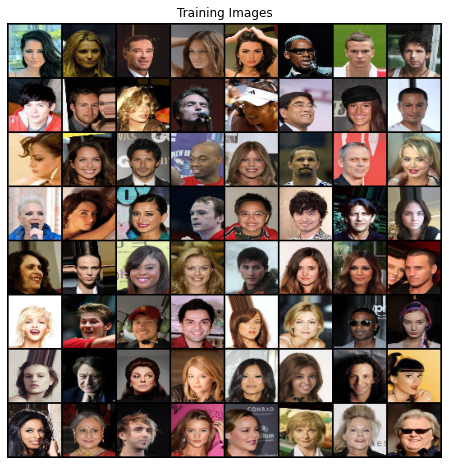

In [ ]:
'''
# We have provided a template data loader for your segmentation training
# You need to complete the __getitem__() function before running the code
# You may also need to add data augmentation or normalization in here
'''

class CelebDataset(Dataset):
  def __init__(self):
      self.transforms = transforms.Compose([
          # transforms.Resize(image_size),
          transforms.CenterCrop(image_size),
          transforms.ToTensor(),
          transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
      ])
      self.file = h5py.File(hdf5_path, mode='r')
      print('loaded file\n')
      print(self.file)

  '''
  # you can change the value of length to a small number like 10 for debugging of your training procedure and overfeating
  # make sure to use the correct length for the final training
  '''
  def __len__(self):
      return self.file['train_X'].shape[0]

  def numpy_to_tensor(self, img):
    if self.transforms is not None:
        img = self.transforms(img)
    img = torch.tensor(img, dtype=torch.float)
    return img

  '''
  # Complete this part by using get_instance_sample function
  # make sure to resize the img and mask to a fixed size (for example 128*128)
  # you can use "interpolate" function of pytorch or "numpy.resize"
  # TODO: 5 lines
  '''
  def __getitem__(self, idx):
    img = self.file['train_X'][idx, ...]
    
    img = Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

    return self.numpy_to_tensor(img)


# Create dataset
dataset = CelebDataset()

# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
print('cuda?',torch.cuda.is_available())
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

# Models

In [ ]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)


class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

    
# Create the generator
# '''
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)
# '''

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


# Training

Starting Training Loop...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[0/15][0/1583]	Loss_D: 3.0396	Loss_G: 1.7872	D(x): 0.1227	D(G(z)): 0.3074 / 0.2063


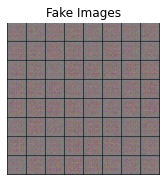

[0/15][50/1583]	Loss_D: 4.5905	Loss_G: 16.1180	D(x): 0.9309	D(G(z)): 0.8014 / 0.0004
[0/15][100/1583]	Loss_D: 1.2058	Loss_G: 6.5391	D(x): 0.7649	D(G(z)): 0.5069 / 0.0079
[0/15][150/1583]	Loss_D: 0.9026	Loss_G: 3.0893	D(x): 0.7830	D(G(z)): 0.4083 / 0.0840
[0/15][200/1583]	Loss_D: 1.1023	Loss_G: 2.5882	D(x): 0.5266	D(G(z)): 0.1074 / 0.0984
[0/15][250/1583]	Loss_D: 1.0169	Loss_G: 4.1475	D(x): 0.7480	D(G(z)): 0.4630 / 0.0300
[0/15][300/1583]	Loss_D: 0.8657	Loss_G: 2.1807	D(x): 0.6582	D(G(z)): 0.2810 / 0.1391
[0/15][350/1583]	Loss_D: 1.3389	Loss_G: 4.8734	D(x): 0.7651	D(G(z)): 0.5360 / 0.0215
[0/15][400/1583]	Loss_D: 0.7374	Loss_G: 2.3037	D(x): 0.6205	D(G(z)): 0.1112 / 0.1271
[0/15][450/1583]	Loss_D: 0.7898	Loss_G: 2.2331	D(x): 0.7229	D(G(z)): 0.3076 / 0.1528
[0/15][500/1583]	Loss_D: 0.8073	Loss_G: 3.3806	D(x): 0.7112	D(G(z)): 0.3214 / 0.0487


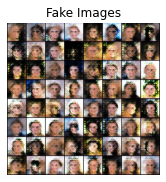

[0/15][550/1583]	Loss_D: 1.0033	Loss_G: 3.8701	D(x): 0.8395	D(G(z)): 0.5192 / 0.0301
[0/15][600/1583]	Loss_D: 0.9512	Loss_G: 3.7824	D(x): 0.7550	D(G(z)): 0.3852 / 0.0522
[0/15][650/1583]	Loss_D: 1.2297	Loss_G: 2.9843	D(x): 0.8038	D(G(z)): 0.5652 / 0.0793
[0/15][700/1583]	Loss_D: 0.9072	Loss_G: 2.8441	D(x): 0.7142	D(G(z)): 0.3690 / 0.0765
[0/15][750/1583]	Loss_D: 1.3457	Loss_G: 5.2237	D(x): 0.8420	D(G(z)): 0.6173 / 0.0141
[0/15][800/1583]	Loss_D: 1.1965	Loss_G: 3.9726	D(x): 0.7438	D(G(z)): 0.5283 / 0.0284
[0/15][850/1583]	Loss_D: 0.8434	Loss_G: 4.6077	D(x): 0.8192	D(G(z)): 0.3849 / 0.0204
[0/15][900/1583]	Loss_D: 0.9353	Loss_G: 2.9898	D(x): 0.5642	D(G(z)): 0.1683 / 0.0796
[0/15][950/1583]	Loss_D: 1.0327	Loss_G: 3.0335	D(x): 0.8332	D(G(z)): 0.5053 / 0.0643
[0/15][1000/1583]	Loss_D: 0.7385	Loss_G: 2.6733	D(x): 0.6286	D(G(z)): 0.1723 / 0.0943


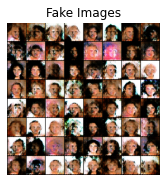

[0/15][1050/1583]	Loss_D: 1.1974	Loss_G: 1.2888	D(x): 0.4254	D(G(z)): 0.0977 / 0.3265
[0/15][1100/1583]	Loss_D: 0.7565	Loss_G: 3.6107	D(x): 0.6823	D(G(z)): 0.2148 / 0.0448
[0/15][1150/1583]	Loss_D: 0.6946	Loss_G: 2.9147	D(x): 0.7627	D(G(z)): 0.2817 / 0.0812
[0/15][1200/1583]	Loss_D: 1.4990	Loss_G: 5.1704	D(x): 0.9320	D(G(z)): 0.7071 / 0.0095
[0/15][1250/1583]	Loss_D: 0.4197	Loss_G: 3.1567	D(x): 0.8653	D(G(z)): 0.2093 / 0.0563
[0/15][1300/1583]	Loss_D: 1.1330	Loss_G: 4.5434	D(x): 0.9188	D(G(z)): 0.6003 / 0.0188
[0/15][1350/1583]	Loss_D: 1.0203	Loss_G: 1.3562	D(x): 0.4956	D(G(z)): 0.0706 / 0.3059
[0/15][1400/1583]	Loss_D: 0.6284	Loss_G: 2.9176	D(x): 0.7681	D(G(z)): 0.2317 / 0.0813
[0/15][1450/1583]	Loss_D: 0.7736	Loss_G: 3.6982	D(x): 0.9030	D(G(z)): 0.4259 / 0.0390
[0/15][1500/1583]	Loss_D: 0.5831	Loss_G: 2.9062	D(x): 0.7722	D(G(z)): 0.2191 / 0.0707


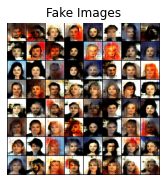

[0/15][1550/1583]	Loss_D: 1.7263	Loss_G: 1.5980	D(x): 0.2833	D(G(z)): 0.0304 / 0.2876


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[1/15][0/1583]	Loss_D: 0.5532	Loss_G: 3.0271	D(x): 0.8107	D(G(z)): 0.2508 / 0.0817
[1/15][50/1583]	Loss_D: 0.8640	Loss_G: 2.2835	D(x): 0.6754	D(G(z)): 0.3021 / 0.1285
[1/15][100/1583]	Loss_D: 0.6998	Loss_G: 2.4155	D(x): 0.7014	D(G(z)): 0.2213 / 0.1233
[1/15][150/1583]	Loss_D: 1.0461	Loss_G: 1.5396	D(x): 0.4462	D(G(z)): 0.1062 / 0.2448
[1/15][200/1583]	Loss_D: 1.0298	Loss_G: 1.5460	D(x): 0.5435	D(G(z)): 0.2316 / 0.2635
[1/15][250/1583]	Loss_D: 0.6173	Loss_G: 2.7209	D(x): 0.7515	D(G(z)): 0.2220 / 0.0878
[1/15][300/1583]	Loss_D: 0.8941	Loss_G: 2.8417	D(x): 0.6895	D(G(z)): 0.3197 / 0.0840
[1/15][350/1583]	Loss_D: 0.8752	Loss_G: 1.5810	D(x): 0.5694	D(G(z)): 0.1788 / 0.2500
[1/15][400/1583]	Loss_D: 1.0456	Loss_G: 5.3943	D(x): 0.8582	D(G(z)): 0.5169 / 0.0107


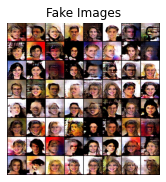

[1/15][450/1583]	Loss_D: 1.0376	Loss_G: 3.1420	D(x): 0.8221	D(G(z)): 0.5108 / 0.0576
[1/15][500/1583]	Loss_D: 0.8004	Loss_G: 2.4920	D(x): 0.7487	D(G(z)): 0.3396 / 0.1034
[1/15][550/1583]	Loss_D: 1.0830	Loss_G: 1.4488	D(x): 0.4606	D(G(z)): 0.0954 / 0.2943
[1/15][600/1583]	Loss_D: 0.9735	Loss_G: 3.1715	D(x): 0.7720	D(G(z)): 0.4436 / 0.0632
[1/15][650/1583]	Loss_D: 1.0368	Loss_G: 3.5190	D(x): 0.7697	D(G(z)): 0.4564 / 0.0519
[1/15][700/1583]	Loss_D: 0.5358	Loss_G: 3.1742	D(x): 0.7818	D(G(z)): 0.2156 / 0.0623
[1/15][750/1583]	Loss_D: 0.6101	Loss_G: 2.8908	D(x): 0.7673	D(G(z)): 0.2506 / 0.0741
[1/15][800/1583]	Loss_D: 1.0130	Loss_G: 1.7386	D(x): 0.5054	D(G(z)): 0.1469 / 0.2172
[1/15][850/1583]	Loss_D: 0.9716	Loss_G: 1.3074	D(x): 0.5342	D(G(z)): 0.1999 / 0.3105
[1/15][900/1583]	Loss_D: 1.1578	Loss_G: 1.4440	D(x): 0.4117	D(G(z)): 0.0754 / 0.2888


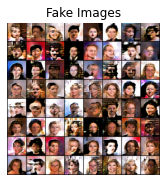

[1/15][950/1583]	Loss_D: 0.8719	Loss_G: 1.3794	D(x): 0.5445	D(G(z)): 0.1236 / 0.3100
[1/15][1000/1583]	Loss_D: 0.9235	Loss_G: 1.7861	D(x): 0.5788	D(G(z)): 0.2265 / 0.2100
[1/15][1050/1583]	Loss_D: 0.7172	Loss_G: 2.2170	D(x): 0.6827	D(G(z)): 0.2290 / 0.1415
[1/15][1100/1583]	Loss_D: 0.9115	Loss_G: 2.8887	D(x): 0.7468	D(G(z)): 0.4048 / 0.0813
[1/15][1150/1583]	Loss_D: 0.7691	Loss_G: 2.3128	D(x): 0.7283	D(G(z)): 0.3007 / 0.1281
[1/15][1200/1583]	Loss_D: 1.9273	Loss_G: 1.4047	D(x): 0.2212	D(G(z)): 0.0161 / 0.3202
[1/15][1250/1583]	Loss_D: 0.7189	Loss_G: 2.7745	D(x): 0.7932	D(G(z)): 0.3429 / 0.0808
[1/15][1300/1583]	Loss_D: 0.9801	Loss_G: 3.3688	D(x): 0.8420	D(G(z)): 0.5063 / 0.0498
[1/15][1350/1583]	Loss_D: 1.5015	Loss_G: 2.1854	D(x): 0.3217	D(G(z)): 0.0417 / 0.1700
[1/15][1400/1583]	Loss_D: 1.2874	Loss_G: 1.1853	D(x): 0.3656	D(G(z)): 0.0734 / 0.3628


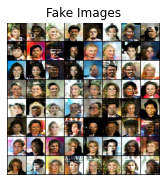

[1/15][1450/1583]	Loss_D: 0.7884	Loss_G: 3.2609	D(x): 0.8295	D(G(z)): 0.4023 / 0.0507
[1/15][1500/1583]	Loss_D: 0.7773	Loss_G: 1.7470	D(x): 0.5856	D(G(z)): 0.1382 / 0.2061
[1/15][1550/1583]	Loss_D: 1.0373	Loss_G: 1.3752	D(x): 0.4368	D(G(z)): 0.0821 / 0.2969


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[2/15][0/1583]	Loss_D: 0.7349	Loss_G: 2.3851	D(x): 0.6932	D(G(z)): 0.2493 / 0.1252
[2/15][50/1583]	Loss_D: 1.0419	Loss_G: 0.9841	D(x): 0.4707	D(G(z)): 0.1326 / 0.4149
[2/15][100/1583]	Loss_D: 0.7933	Loss_G: 2.4860	D(x): 0.6618	D(G(z)): 0.2611 / 0.1143
[2/15][150/1583]	Loss_D: 0.7813	Loss_G: 2.0529	D(x): 0.6151	D(G(z)): 0.2017 / 0.1591
[2/15][200/1583]	Loss_D: 0.8587	Loss_G: 3.0421	D(x): 0.8123	D(G(z)): 0.4112 / 0.0700
[2/15][250/1583]	Loss_D: 0.6034	Loss_G: 2.3070	D(x): 0.7170	D(G(z)): 0.1839 / 0.1335
[2/15][300/1583]	Loss_D: 0.9286	Loss_G: 2.7024	D(x): 0.7127	D(G(z)): 0.3736 / 0.0891


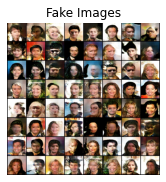

[2/15][350/1583]	Loss_D: 0.9196	Loss_G: 1.8131	D(x): 0.6623	D(G(z)): 0.3337 / 0.2148
[2/15][400/1583]	Loss_D: 0.7486	Loss_G: 1.4594	D(x): 0.5894	D(G(z)): 0.1454 / 0.2694
[2/15][450/1583]	Loss_D: 1.2899	Loss_G: 0.5931	D(x): 0.3674	D(G(z)): 0.0855 / 0.5968
[2/15][500/1583]	Loss_D: 0.8318	Loss_G: 2.5363	D(x): 0.7342	D(G(z)): 0.3386 / 0.1076
[2/15][550/1583]	Loss_D: 0.8411	Loss_G: 2.0255	D(x): 0.6287	D(G(z)): 0.2478 / 0.1633
[2/15][600/1583]	Loss_D: 0.9806	Loss_G: 1.1904	D(x): 0.5203	D(G(z)): 0.1957 / 0.3402
[2/15][650/1583]	Loss_D: 0.9065	Loss_G: 2.1633	D(x): 0.6141	D(G(z)): 0.2793 / 0.1569
[2/15][700/1583]	Loss_D: 1.5537	Loss_G: 2.9627	D(x): 0.7596	D(G(z)): 0.6619 / 0.0715
[2/15][750/1583]	Loss_D: 1.1711	Loss_G: 0.8398	D(x): 0.4079	D(G(z)): 0.1078 / 0.4777
[2/15][800/1583]	Loss_D: 0.8792	Loss_G: 1.5147	D(x): 0.5480	D(G(z)): 0.1666 / 0.2697


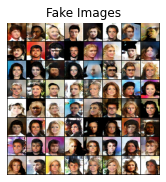

[2/15][850/1583]	Loss_D: 0.7241	Loss_G: 1.6021	D(x): 0.6145	D(G(z)): 0.1458 / 0.2545
[2/15][900/1583]	Loss_D: 0.9156	Loss_G: 1.7800	D(x): 0.5412	D(G(z)): 0.1523 / 0.2147
[2/15][950/1583]	Loss_D: 0.9248	Loss_G: 1.3399	D(x): 0.5899	D(G(z)): 0.2554 / 0.3050
[2/15][1000/1583]	Loss_D: 0.6889	Loss_G: 2.6774	D(x): 0.7554	D(G(z)): 0.2871 / 0.0933
[2/15][1050/1583]	Loss_D: 0.8692	Loss_G: 1.3383	D(x): 0.5240	D(G(z)): 0.1142 / 0.3016
[2/15][1100/1583]	Loss_D: 0.9318	Loss_G: 1.6150	D(x): 0.5428	D(G(z)): 0.1756 / 0.2378
[2/15][1150/1583]	Loss_D: 1.3241	Loss_G: 2.9797	D(x): 0.9183	D(G(z)): 0.6412 / 0.0692
[2/15][1200/1583]	Loss_D: 0.8669	Loss_G: 2.2658	D(x): 0.6956	D(G(z)): 0.3346 / 0.1283
[2/15][1250/1583]	Loss_D: 1.0941	Loss_G: 3.7344	D(x): 0.8864	D(G(z)): 0.5574 / 0.0332
[2/15][1300/1583]	Loss_D: 0.8303	Loss_G: 1.7694	D(x): 0.5866	D(G(z)): 0.1879 / 0.2091


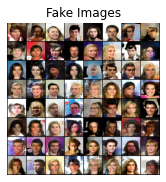

[2/15][1350/1583]	Loss_D: 0.9787	Loss_G: 3.3275	D(x): 0.7869	D(G(z)): 0.4643 / 0.0514
[2/15][1400/1583]	Loss_D: 1.4050	Loss_G: 1.1524	D(x): 0.3119	D(G(z)): 0.0445 / 0.3862
[2/15][1450/1583]	Loss_D: 0.8543	Loss_G: 2.0027	D(x): 0.6798	D(G(z)): 0.3171 / 0.1668
[2/15][1500/1583]	Loss_D: 0.8123	Loss_G: 1.6802	D(x): 0.5918	D(G(z)): 0.1766 / 0.2292
[2/15][1550/1583]	Loss_D: 1.0405	Loss_G: 2.2504	D(x): 0.6503	D(G(z)): 0.3398 / 0.1423


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[3/15][0/1583]	Loss_D: 0.9171	Loss_G: 1.8098	D(x): 0.5906	D(G(z)): 0.2599 / 0.2076
[3/15][50/1583]	Loss_D: 0.9460	Loss_G: 2.6094	D(x): 0.7773	D(G(z)): 0.4482 / 0.0940
[3/15][100/1583]	Loss_D: 0.8084	Loss_G: 2.7245	D(x): 0.7841	D(G(z)): 0.3722 / 0.0907
[3/15][150/1583]	Loss_D: 0.8066	Loss_G: 2.6853	D(x): 0.7413	D(G(z)): 0.3438 / 0.0862
[3/15][200/1583]	Loss_D: 0.9678	Loss_G: 2.6837	D(x): 0.7632	D(G(z)): 0.4378 / 0.0943
[3/15][250/1583]	Loss_D: 3.7761	Loss_G: 0.0908	D(x): 0.0545	D(G(z)): 0.0188 / 0.9172


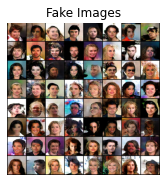

[3/15][300/1583]	Loss_D: 0.7243	Loss_G: 2.5188	D(x): 0.7781	D(G(z)): 0.3379 / 0.1065
[3/15][350/1583]	Loss_D: 1.0282	Loss_G: 1.0990	D(x): 0.4540	D(G(z)): 0.0851 / 0.3730
[3/15][400/1583]	Loss_D: 0.9996	Loss_G: 1.6414	D(x): 0.5751	D(G(z)): 0.2777 / 0.2300
[3/15][450/1583]	Loss_D: 1.0466	Loss_G: 3.1721	D(x): 0.8086	D(G(z)): 0.5162 / 0.0549
[3/15][500/1583]	Loss_D: 2.4848	Loss_G: 0.3998	D(x): 0.1285	D(G(z)): 0.0196 / 0.7207
[3/15][550/1583]	Loss_D: 0.8291	Loss_G: 1.3357	D(x): 0.6043	D(G(z)): 0.2185 / 0.2990
[3/15][600/1583]	Loss_D: 0.8785	Loss_G: 1.3564	D(x): 0.6764	D(G(z)): 0.3328 / 0.2861
[3/15][650/1583]	Loss_D: 0.8848	Loss_G: 3.0349	D(x): 0.7762	D(G(z)): 0.4083 / 0.0671
[3/15][700/1583]	Loss_D: 1.1172	Loss_G: 3.6108	D(x): 0.8316	D(G(z)): 0.5615 / 0.0385
[3/15][750/1583]	Loss_D: 0.8945	Loss_G: 2.6108	D(x): 0.7915	D(G(z)): 0.4343 / 0.1047


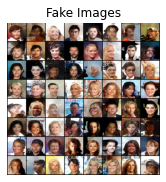

[3/15][800/1583]	Loss_D: 0.7360	Loss_G: 1.9661	D(x): 0.6511	D(G(z)): 0.2126 / 0.1681
[3/15][850/1583]	Loss_D: 0.6724	Loss_G: 1.9515	D(x): 0.7099	D(G(z)): 0.2373 / 0.1753
[3/15][900/1583]	Loss_D: 0.7645	Loss_G: 2.7619	D(x): 0.8194	D(G(z)): 0.3725 / 0.0907
[3/15][950/1583]	Loss_D: 0.9562	Loss_G: 3.5835	D(x): 0.8077	D(G(z)): 0.4602 / 0.0469
[3/15][1000/1583]	Loss_D: 0.7461	Loss_G: 2.4487	D(x): 0.6901	D(G(z)): 0.2598 / 0.1070
[3/15][1050/1583]	Loss_D: 1.1521	Loss_G: 3.7888	D(x): 0.9200	D(G(z)): 0.5905 / 0.0324
[3/15][1100/1583]	Loss_D: 1.3614	Loss_G: 4.4747	D(x): 0.8051	D(G(z)): 0.6128 / 0.0178
[3/15][1150/1583]	Loss_D: 0.7156	Loss_G: 2.8883	D(x): 0.8183	D(G(z)): 0.3560 / 0.0708
[3/15][1200/1583]	Loss_D: 0.9421	Loss_G: 3.4892	D(x): 0.8843	D(G(z)): 0.5061 / 0.0431
[3/15][1250/1583]	Loss_D: 1.5869	Loss_G: 0.8203	D(x): 0.2800	D(G(z)): 0.0454 / 0.4895


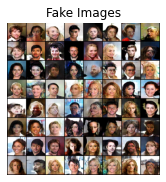

[3/15][1300/1583]	Loss_D: 0.9456	Loss_G: 1.1420	D(x): 0.5912	D(G(z)): 0.2536 / 0.3610
[3/15][1350/1583]	Loss_D: 0.6005	Loss_G: 2.3852	D(x): 0.7156	D(G(z)): 0.1865 / 0.1230
[3/15][1400/1583]	Loss_D: 0.7765	Loss_G: 1.8812	D(x): 0.6343	D(G(z)): 0.2134 / 0.1917
[3/15][1450/1583]	Loss_D: 0.9526	Loss_G: 4.4225	D(x): 0.8604	D(G(z)): 0.4817 / 0.0169
[3/15][1500/1583]	Loss_D: 0.8468	Loss_G: 2.1195	D(x): 0.7420	D(G(z)): 0.3512 / 0.1549
[3/15][1550/1583]	Loss_D: 1.0225	Loss_G: 2.8172	D(x): 0.8070	D(G(z)): 0.5056 / 0.0812


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[4/15][0/1583]	Loss_D: 0.6161	Loss_G: 2.6337	D(x): 0.7600	D(G(z)): 0.2557 / 0.0848
[4/15][50/1583]	Loss_D: 0.8609	Loss_G: 2.8117	D(x): 0.8576	D(G(z)): 0.4438 / 0.0835
[4/15][100/1583]	Loss_D: 0.8300	Loss_G: 2.0280	D(x): 0.6247	D(G(z)): 0.2185 / 0.1768
[4/15][150/1583]	Loss_D: 1.0904	Loss_G: 0.6467	D(x): 0.4211	D(G(z)): 0.0760 / 0.5631


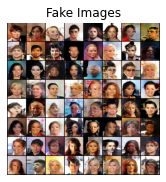

[4/15][200/1583]	Loss_D: 0.6517	Loss_G: 1.9403	D(x): 0.7072	D(G(z)): 0.2303 / 0.1703
[4/15][250/1583]	Loss_D: 1.1457	Loss_G: 0.7998	D(x): 0.4202	D(G(z)): 0.0874 / 0.4961
[4/15][300/1583]	Loss_D: 0.7490	Loss_G: 1.6825	D(x): 0.6008	D(G(z)): 0.1455 / 0.2301
[4/15][350/1583]	Loss_D: 0.8643	Loss_G: 1.5848	D(x): 0.5455	D(G(z)): 0.1415 / 0.2539
[4/15][400/1583]	Loss_D: 1.2707	Loss_G: 3.9688	D(x): 0.7648	D(G(z)): 0.5535 / 0.0336
[4/15][450/1583]	Loss_D: 1.2377	Loss_G: 3.9733	D(x): 0.7940	D(G(z)): 0.5685 / 0.0285
[4/15][500/1583]	Loss_D: 0.7801	Loss_G: 1.9958	D(x): 0.6812	D(G(z)): 0.2308 / 0.1720
[4/15][550/1583]	Loss_D: 0.7084	Loss_G: 1.6206	D(x): 0.6256	D(G(z)): 0.1443 / 0.2468
[4/15][600/1583]	Loss_D: 1.1442	Loss_G: 1.1989	D(x): 0.4343	D(G(z)): 0.1254 / 0.3705
[4/15][650/1583]	Loss_D: 0.6934	Loss_G: 1.4827	D(x): 0.6197	D(G(z)): 0.1256 / 0.2822


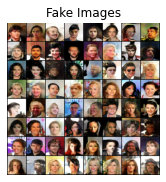

[4/15][700/1583]	Loss_D: 0.6344	Loss_G: 2.9503	D(x): 0.8103	D(G(z)): 0.3000 / 0.0687
[4/15][750/1583]	Loss_D: 0.7539	Loss_G: 3.4052	D(x): 0.8386	D(G(z)): 0.3894 / 0.0474
[4/15][800/1583]	Loss_D: 0.7036	Loss_G: 3.7090	D(x): 0.8777	D(G(z)): 0.3877 / 0.0395
[4/15][850/1583]	Loss_D: 0.5400	Loss_G: 2.3548	D(x): 0.7579	D(G(z)): 0.1920 / 0.1295
[4/15][900/1583]	Loss_D: 0.7160	Loss_G: 2.4911	D(x): 0.7966	D(G(z)): 0.3352 / 0.1107
[4/15][950/1583]	Loss_D: 0.8690	Loss_G: 1.5404	D(x): 0.5218	D(G(z)): 0.0823 / 0.2644
[4/15][1000/1583]	Loss_D: 0.6904	Loss_G: 2.6548	D(x): 0.7313	D(G(z)): 0.2590 / 0.0954
[4/15][1050/1583]	Loss_D: 0.9740	Loss_G: 1.2377	D(x): 0.5056	D(G(z)): 0.1560 / 0.3379
[4/15][1100/1583]	Loss_D: 0.6415	Loss_G: 3.1651	D(x): 0.8869	D(G(z)): 0.3597 / 0.0641
[4/15][1150/1583]	Loss_D: 0.7827	Loss_G: 3.5736	D(x): 0.8577	D(G(z)): 0.4054 / 0.0419


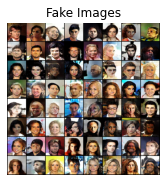

[4/15][1200/1583]	Loss_D: 2.2538	Loss_G: 3.6804	D(x): 0.9428	D(G(z)): 0.8149 / 0.0463
[4/15][1250/1583]	Loss_D: 0.7024	Loss_G: 2.5665	D(x): 0.7913	D(G(z)): 0.3234 / 0.1023
[4/15][1300/1583]	Loss_D: 0.9930	Loss_G: 0.2463	D(x): 0.4592	D(G(z)): 0.0569 / 0.8037
[4/15][1350/1583]	Loss_D: 0.7948	Loss_G: 3.3180	D(x): 0.9503	D(G(z)): 0.4670 / 0.0514
[4/15][1400/1583]	Loss_D: 0.5467	Loss_G: 2.5842	D(x): 0.7856	D(G(z)): 0.2262 / 0.1019
[4/15][1450/1583]	Loss_D: 0.8021	Loss_G: 1.6350	D(x): 0.5368	D(G(z)): 0.0744 / 0.2495
[4/15][1500/1583]	Loss_D: 0.6296	Loss_G: 2.3304	D(x): 0.6085	D(G(z)): 0.0566 / 0.1519
[4/15][1550/1583]	Loss_D: 0.5797	Loss_G: 2.5048	D(x): 0.7954	D(G(z)): 0.2450 / 0.1100


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[5/15][0/1583]	Loss_D: 0.4515	Loss_G: 2.7360	D(x): 0.8359	D(G(z)): 0.2117 / 0.0831
[5/15][50/1583]	Loss_D: 1.2357	Loss_G: 1.0860	D(x): 0.3731	D(G(z)): 0.0509 / 0.3984


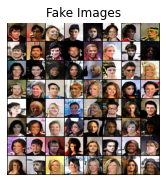

[5/15][100/1583]	Loss_D: 0.6105	Loss_G: 2.9533	D(x): 0.8668	D(G(z)): 0.3328 / 0.0701
[5/15][150/1583]	Loss_D: 0.5172	Loss_G: 3.4590	D(x): 0.8385	D(G(z)): 0.2593 / 0.0426
[5/15][200/1583]	Loss_D: 0.5938	Loss_G: 3.4332	D(x): 0.7931	D(G(z)): 0.2483 / 0.0520
[5/15][250/1583]	Loss_D: 0.8424	Loss_G: 3.5682	D(x): 0.9162	D(G(z)): 0.4674 / 0.0432
[5/15][300/1583]	Loss_D: 1.2412	Loss_G: 0.7529	D(x): 0.3810	D(G(z)): 0.0426 / 0.5398
[5/15][350/1583]	Loss_D: 1.0310	Loss_G: 4.6670	D(x): 0.9428	D(G(z)): 0.5486 / 0.0147
[5/15][400/1583]	Loss_D: 0.6667	Loss_G: 2.1957	D(x): 0.5955	D(G(z)): 0.0679 / 0.1729
[5/15][450/1583]	Loss_D: 0.4525	Loss_G: 3.1875	D(x): 0.8080	D(G(z)): 0.1818 / 0.0622
[5/15][500/1583]	Loss_D: 0.7428	Loss_G: 4.5376	D(x): 0.9194	D(G(z)): 0.4400 / 0.0152
[5/15][550/1583]	Loss_D: 0.4705	Loss_G: 3.4971	D(x): 0.8392	D(G(z)): 0.2207 / 0.0435


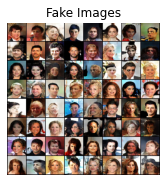

[5/15][600/1583]	Loss_D: 0.6949	Loss_G: 3.1170	D(x): 0.8614	D(G(z)): 0.3648 / 0.0622
[5/15][650/1583]	Loss_D: 0.4645	Loss_G: 3.4758	D(x): 0.9281	D(G(z)): 0.2900 / 0.0418
[5/15][700/1583]	Loss_D: 0.5754	Loss_G: 2.8333	D(x): 0.7439	D(G(z)): 0.1900 / 0.0787
[5/15][750/1583]	Loss_D: 0.4169	Loss_G: 2.5678	D(x): 0.7735	D(G(z)): 0.1221 / 0.1155
[5/15][800/1583]	Loss_D: 0.8526	Loss_G: 4.2662	D(x): 0.9574	D(G(z)): 0.4703 / 0.0236
[5/15][850/1583]	Loss_D: 0.5830	Loss_G: 2.6818	D(x): 0.6968	D(G(z)): 0.1400 / 0.0956
[5/15][900/1583]	Loss_D: 0.5756	Loss_G: 2.7784	D(x): 0.7986	D(G(z)): 0.2495 / 0.0837
[5/15][950/1583]	Loss_D: 0.7888	Loss_G: 3.8524	D(x): 0.9578	D(G(z)): 0.4641 / 0.0303
[5/15][1000/1583]	Loss_D: 0.4856	Loss_G: 2.4025	D(x): 0.8488	D(G(z)): 0.2328 / 0.1239
[5/15][1050/1583]	Loss_D: 0.4460	Loss_G: 2.9808	D(x): 0.8337	D(G(z)): 0.2066 / 0.0703


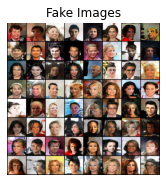

[5/15][1100/1583]	Loss_D: 0.6462	Loss_G: 5.0007	D(x): 0.9275	D(G(z)): 0.3757 / 0.0106
[5/15][1150/1583]	Loss_D: 0.4375	Loss_G: 2.2616	D(x): 0.8035	D(G(z)): 0.1509 / 0.1435
[5/15][1200/1583]	Loss_D: 1.4554	Loss_G: 5.6061	D(x): 0.9600	D(G(z)): 0.6829 / 0.0062
[5/15][1250/1583]	Loss_D: 1.0678	Loss_G: 0.7621	D(x): 0.4362	D(G(z)): 0.0529 / 0.5453
[5/15][1300/1583]	Loss_D: 0.5852	Loss_G: 4.4336	D(x): 0.9427	D(G(z)): 0.3527 / 0.0180
[5/15][1350/1583]	Loss_D: 0.4225	Loss_G: 2.8011	D(x): 0.8158	D(G(z)): 0.1624 / 0.0847
[5/15][1400/1583]	Loss_D: 1.2522	Loss_G: 0.7341	D(x): 0.3719	D(G(z)): 0.0241 / 0.5582
[5/15][1450/1583]	Loss_D: 0.6824	Loss_G: 3.5681	D(x): 0.7711	D(G(z)): 0.2611 / 0.0607
[5/15][1500/1583]	Loss_D: 0.4076	Loss_G: 3.5011	D(x): 0.8717	D(G(z)): 0.2116 / 0.0422
[5/15][1550/1583]	Loss_D: 0.4466	Loss_G: 3.3618	D(x): 0.8973	D(G(z)): 0.2462 / 0.0502


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[6/15][0/1583]	Loss_D: 0.6657	Loss_G: 1.5822	D(x): 0.6181	D(G(z)): 0.0751 / 0.2787


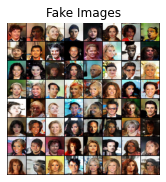

[6/15][50/1583]	Loss_D: 0.5373	Loss_G: 3.3673	D(x): 0.8109	D(G(z)): 0.2253 / 0.0504
[6/15][100/1583]	Loss_D: 0.4203	Loss_G: 2.0414	D(x): 0.7616	D(G(z)): 0.1053 / 0.1739
[6/15][150/1583]	Loss_D: 0.6125	Loss_G: 1.9186	D(x): 0.6451	D(G(z)): 0.0710 / 0.2119
[6/15][200/1583]	Loss_D: 1.5486	Loss_G: 0.6006	D(x): 0.2932	D(G(z)): 0.0191 / 0.6065
[6/15][250/1583]	Loss_D: 0.3724	Loss_G: 3.5331	D(x): 0.8706	D(G(z)): 0.1849 / 0.0430
[6/15][300/1583]	Loss_D: 0.5931	Loss_G: 2.5772	D(x): 0.7219	D(G(z)): 0.1572 / 0.1178
[6/15][350/1583]	Loss_D: 0.2854	Loss_G: 3.5345	D(x): 0.8763	D(G(z)): 0.1268 / 0.0424
[6/15][400/1583]	Loss_D: 0.8331	Loss_G: 1.0578	D(x): 0.5304	D(G(z)): 0.0376 / 0.4266
[6/15][450/1583]	Loss_D: 0.7908	Loss_G: 3.0036	D(x): 0.6524	D(G(z)): 0.1579 / 0.0911
[6/15][500/1583]	Loss_D: 0.9199	Loss_G: 1.8215	D(x): 0.4830	D(G(z)): 0.0255 / 0.2182


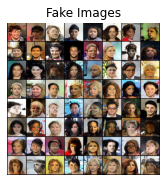

[6/15][550/1583]	Loss_D: 0.4331	Loss_G: 1.9587	D(x): 0.7625	D(G(z)): 0.1018 / 0.1897
[6/15][600/1583]	Loss_D: 0.7427	Loss_G: 1.5467	D(x): 0.5585	D(G(z)): 0.0367 / 0.2762
[6/15][650/1583]	Loss_D: 0.7184	Loss_G: 1.4699	D(x): 0.5902	D(G(z)): 0.0396 / 0.3084
[6/15][700/1583]	Loss_D: 0.5821	Loss_G: 1.6572	D(x): 0.6519	D(G(z)): 0.0738 / 0.2362
[6/15][750/1583]	Loss_D: 0.5961	Loss_G: 5.6357	D(x): 0.9512	D(G(z)): 0.3512 / 0.0056
[6/15][800/1583]	Loss_D: 0.7536	Loss_G: 4.9925	D(x): 0.9516	D(G(z)): 0.4439 / 0.0114
[6/15][850/1583]	Loss_D: 0.2366	Loss_G: 3.3661	D(x): 0.8781	D(G(z)): 0.0874 / 0.0482
[6/15][900/1583]	Loss_D: 0.5826	Loss_G: 3.0296	D(x): 0.7773	D(G(z)): 0.2000 / 0.0830
[6/15][950/1583]	Loss_D: 0.3100	Loss_G: 3.7501	D(x): 0.9122	D(G(z)): 0.1722 / 0.0333
[6/15][1000/1583]	Loss_D: 0.4514	Loss_G: 2.8635	D(x): 0.6987	D(G(z)): 0.0311 / 0.0935


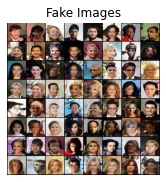

[6/15][1050/1583]	Loss_D: 0.3630	Loss_G: 3.6443	D(x): 0.9014	D(G(z)): 0.2007 / 0.0356
[6/15][1100/1583]	Loss_D: 0.4752	Loss_G: 3.5893	D(x): 0.8053	D(G(z)): 0.1614 / 0.0485
[6/15][1150/1583]	Loss_D: 0.6859	Loss_G: 6.2102	D(x): 0.9625	D(G(z)): 0.4064 / 0.0040
[6/15][1200/1583]	Loss_D: 0.4558	Loss_G: 2.1070	D(x): 0.7753	D(G(z)): 0.1324 / 0.1772
[6/15][1250/1583]	Loss_D: 0.6866	Loss_G: 1.2892	D(x): 0.6406	D(G(z)): 0.1312 / 0.3351
[6/15][1300/1583]	Loss_D: 0.3953	Loss_G: 1.9334	D(x): 0.7738	D(G(z)): 0.0829 / 0.2073
[6/15][1350/1583]	Loss_D: 0.3746	Loss_G: 2.6826	D(x): 0.8196	D(G(z)): 0.1228 / 0.1066
[6/15][1400/1583]	Loss_D: 1.2756	Loss_G: 0.8658	D(x): 0.3665	D(G(z)): 0.0128 / 0.5063
[6/15][1450/1583]	Loss_D: 0.5185	Loss_G: 1.6204	D(x): 0.7403	D(G(z)): 0.1213 / 0.2656
[6/15][1500/1583]	Loss_D: 0.3746	Loss_G: 3.1521	D(x): 0.8693	D(G(z)): 0.1817 / 0.0588


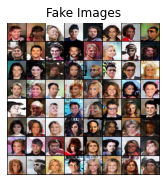

[6/15][1550/1583]	Loss_D: 0.3263	Loss_G: 2.9301	D(x): 0.8281	D(G(z)): 0.1025 / 0.0810


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[7/15][0/1583]	Loss_D: 0.5413	Loss_G: 2.2291	D(x): 0.6528	D(G(z)): 0.0560 / 0.1533
[7/15][50/1583]	Loss_D: 0.3042	Loss_G: 2.7543	D(x): 0.8008	D(G(z)): 0.0468 / 0.1023
[7/15][100/1583]	Loss_D: 0.8363	Loss_G: 0.8504	D(x): 0.5842	D(G(z)): 0.0981 / 0.5095
[7/15][150/1583]	Loss_D: 0.2655	Loss_G: 2.9814	D(x): 0.8777	D(G(z)): 0.1071 / 0.0747
[7/15][200/1583]	Loss_D: 0.2428	Loss_G: 4.0305	D(x): 0.9227	D(G(z)): 0.1385 / 0.0238
[7/15][250/1583]	Loss_D: 0.1702	Loss_G: 4.0074	D(x): 0.9247	D(G(z)): 0.0786 / 0.0305
[7/15][300/1583]	Loss_D: 1.0569	Loss_G: 6.1076	D(x): 0.9361	D(G(z)): 0.5298 / 0.0038
[7/15][350/1583]	Loss_D: 0.3236	Loss_G: 3.9569	D(x): 0.9074	D(G(z)): 0.1706 / 0.0289
[7/15][400/1583]	Loss_D: 0.2456	Loss_G: 4.1280	D(x): 0.9623	D(G(z)): 0.1635 / 0.0253


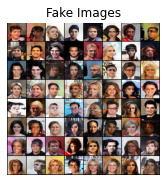

[7/15][450/1583]	Loss_D: 0.7894	Loss_G: 1.4837	D(x): 0.5630	D(G(z)): 0.0373 / 0.3345
[7/15][500/1583]	Loss_D: 0.7922	Loss_G: 1.3312	D(x): 0.5596	D(G(z)): 0.0647 / 0.3721
[7/15][550/1583]	Loss_D: 0.3338	Loss_G: 3.5797	D(x): 0.8586	D(G(z)): 0.1336 / 0.0444
[7/15][600/1583]	Loss_D: 0.2284	Loss_G: 3.4415	D(x): 0.9242	D(G(z)): 0.1195 / 0.0471
[7/15][650/1583]	Loss_D: 0.2348	Loss_G: 3.0795	D(x): 0.9022	D(G(z)): 0.1062 / 0.0763
[7/15][700/1583]	Loss_D: 0.2471	Loss_G: 4.6008	D(x): 0.9412	D(G(z)): 0.1511 / 0.0154
[7/15][750/1583]	Loss_D: 0.8228	Loss_G: 3.7651	D(x): 0.7617	D(G(z)): 0.2335 / 0.1391
[7/15][800/1583]	Loss_D: 0.2897	Loss_G: 3.9332	D(x): 0.8349	D(G(z)): 0.0782 / 0.0394
[7/15][850/1583]	Loss_D: 0.2462	Loss_G: 3.0507	D(x): 0.8796	D(G(z)): 0.0954 / 0.0700
[7/15][900/1583]	Loss_D: 0.2394	Loss_G: 4.0038	D(x): 0.8743	D(G(z)): 0.0835 / 0.0313


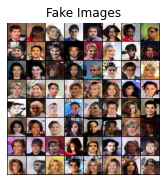

[7/15][950/1583]	Loss_D: 0.2863	Loss_G: 3.3538	D(x): 0.8402	D(G(z)): 0.0764 / 0.0576
[7/15][1000/1583]	Loss_D: 0.2868	Loss_G: 4.7463	D(x): 0.9556	D(G(z)): 0.1903 / 0.0143
[7/15][1050/1583]	Loss_D: 1.0945	Loss_G: 0.2681	D(x): 0.4351	D(G(z)): 0.0137 / 0.7938
[7/15][1100/1583]	Loss_D: 1.0432	Loss_G: 1.3953	D(x): 0.4513	D(G(z)): 0.0119 / 0.3399
[7/15][1150/1583]	Loss_D: 0.2206	Loss_G: 4.5753	D(x): 0.9491	D(G(z)): 0.1319 / 0.0178
[7/15][1200/1583]	Loss_D: 0.4043	Loss_G: 3.2283	D(x): 0.8706	D(G(z)): 0.1925 / 0.0579
[7/15][1250/1583]	Loss_D: 0.5372	Loss_G: 6.9885	D(x): 0.9845	D(G(z)): 0.3632 / 0.0019
[7/15][1300/1583]	Loss_D: 0.2631	Loss_G: 3.8276	D(x): 0.9453	D(G(z)): 0.1572 / 0.0325
[7/15][1350/1583]	Loss_D: 0.1364	Loss_G: 4.2702	D(x): 0.9157	D(G(z)): 0.0395 / 0.0241
[7/15][1400/1583]	Loss_D: 0.4805	Loss_G: 5.2026	D(x): 0.9094	D(G(z)): 0.2558 / 0.0091


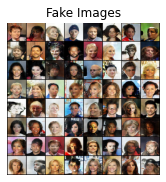

[7/15][1450/1583]	Loss_D: 0.6579	Loss_G: 5.0848	D(x): 0.9581	D(G(z)): 0.3881 / 0.0098
[7/15][1500/1583]	Loss_D: 0.3434	Loss_G: 3.1601	D(x): 0.7671	D(G(z)): 0.0368 / 0.0864
[7/15][1550/1583]	Loss_D: 0.4863	Loss_G: 1.7228	D(x): 0.6961	D(G(z)): 0.0575 / 0.2701


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[8/15][0/1583]	Loss_D: 0.3047	Loss_G: 2.4221	D(x): 0.7831	D(G(z)): 0.0309 / 0.1365
[8/15][50/1583]	Loss_D: 0.5394	Loss_G: 4.6782	D(x): 0.9547	D(G(z)): 0.3139 / 0.0174
[8/15][100/1583]	Loss_D: 0.1542	Loss_G: 3.8886	D(x): 0.9157	D(G(z)): 0.0529 / 0.0345
[8/15][150/1583]	Loss_D: 0.2366	Loss_G: 5.3394	D(x): 0.9799	D(G(z)): 0.1729 / 0.0078
[8/15][200/1583]	Loss_D: 0.7214	Loss_G: 5.4842	D(x): 0.9767	D(G(z)): 0.3983 / 0.0083
[8/15][250/1583]	Loss_D: 2.1587	Loss_G: 1.4543	D(x): 0.1987	D(G(z)): 0.0069 / 0.3303
[8/15][300/1583]	Loss_D: 0.2035	Loss_G: 3.5154	D(x): 0.8839	D(G(z)): 0.0584 / 0.0519


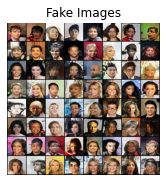

[8/15][350/1583]	Loss_D: 0.1991	Loss_G: 3.9756	D(x): 0.8861	D(G(z)): 0.0548 / 0.0330
[8/15][400/1583]	Loss_D: 0.3787	Loss_G: 2.5830	D(x): 0.8203	D(G(z)): 0.1162 / 0.1133
[8/15][450/1583]	Loss_D: 0.1986	Loss_G: 3.8529	D(x): 0.9222	D(G(z)): 0.0943 / 0.0344
[8/15][500/1583]	Loss_D: 3.3730	Loss_G: 7.1423	D(x): 0.9684	D(G(z)): 0.9084 / 0.0022
[8/15][550/1583]	Loss_D: 0.4136	Loss_G: 4.5955	D(x): 0.9060	D(G(z)): 0.2208 / 0.0184
[8/15][600/1583]	Loss_D: 0.2959	Loss_G: 2.6476	D(x): 0.8442	D(G(z)): 0.0855 / 0.0988
[8/15][650/1583]	Loss_D: 1.3392	Loss_G: 4.5987	D(x): 0.9709	D(G(z)): 0.6161 / 0.0338
[8/15][700/1583]	Loss_D: 0.3843	Loss_G: 3.6128	D(x): 0.8337	D(G(z)): 0.1304 / 0.0435
[8/15][750/1583]	Loss_D: 0.2676	Loss_G: 3.9152	D(x): 0.9429	D(G(z)): 0.1626 / 0.0320
[8/15][800/1583]	Loss_D: 0.3179	Loss_G: 2.6384	D(x): 0.8246	D(G(z)): 0.0841 / 0.1281


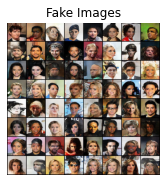

[8/15][850/1583]	Loss_D: 0.1412	Loss_G: 3.5411	D(x): 0.9364	D(G(z)): 0.0634 / 0.0457
[8/15][900/1583]	Loss_D: 0.6622	Loss_G: 2.0958	D(x): 0.5975	D(G(z)): 0.0159 / 0.2036
[8/15][950/1583]	Loss_D: 0.1534	Loss_G: 4.6336	D(x): 0.9083	D(G(z)): 0.0445 / 0.0189
[8/15][1000/1583]	Loss_D: 0.2650	Loss_G: 4.7414	D(x): 0.9574	D(G(z)): 0.1689 / 0.0137
[8/15][1050/1583]	Loss_D: 2.8679	Loss_G: 0.0785	D(x): 0.1230	D(G(z)): 0.0219 / 0.9313
[8/15][1100/1583]	Loss_D: 2.3148	Loss_G: 8.1870	D(x): 0.9970	D(G(z)): 0.8109 / 0.0006
[8/15][1150/1583]	Loss_D: 0.2326	Loss_G: 3.5067	D(x): 0.8791	D(G(z)): 0.0824 / 0.0509
[8/15][1200/1583]	Loss_D: 0.2874	Loss_G: 5.6978	D(x): 0.9841	D(G(z)): 0.2111 / 0.0052
[8/15][1250/1583]	Loss_D: 0.3017	Loss_G: 3.3443	D(x): 0.8248	D(G(z)): 0.0628 / 0.0582
[8/15][1300/1583]	Loss_D: 0.2263	Loss_G: 3.0525	D(x): 0.8748	D(G(z)): 0.0674 / 0.0744


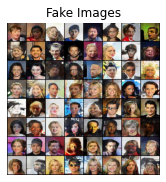

[8/15][1350/1583]	Loss_D: 0.3963	Loss_G: 5.1526	D(x): 0.9079	D(G(z)): 0.2181 / 0.0092
[8/15][1400/1583]	Loss_D: 0.3895	Loss_G: 4.9908	D(x): 0.9184	D(G(z)): 0.2205 / 0.0125
[8/15][1450/1583]	Loss_D: 0.3194	Loss_G: 3.4524	D(x): 0.7901	D(G(z)): 0.0422 / 0.0623
[8/15][1500/1583]	Loss_D: 0.3544	Loss_G: 5.4424	D(x): 0.9821	D(G(z)): 0.2450 / 0.0079
[8/15][1550/1583]	Loss_D: 0.1882	Loss_G: 4.2987	D(x): 0.9230	D(G(z)): 0.0863 / 0.0235


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[9/15][0/1583]	Loss_D: 0.6761	Loss_G: 7.5686	D(x): 0.9950	D(G(z)): 0.4183 / 0.0009
[9/15][50/1583]	Loss_D: 0.3915	Loss_G: 2.7211	D(x): 0.7474	D(G(z)): 0.0497 / 0.1191
[9/15][100/1583]	Loss_D: 0.1590	Loss_G: 4.0694	D(x): 0.9419	D(G(z)): 0.0819 / 0.0297
[9/15][150/1583]	Loss_D: 0.1690	Loss_G: 4.1951	D(x): 0.9498	D(G(z)): 0.0999 / 0.0248
[9/15][200/1583]	Loss_D: 2.1801	Loss_G: 0.3531	D(x): 0.1858	D(G(z)): 0.0066 / 0.7710
[9/15][250/1583]	Loss_D: 0.6680	Loss_G: 1.1841	D(x): 0.5820	D(G(z)): 0.0216 / 0.4119


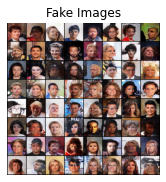

[9/15][300/1583]	Loss_D: 1.3295	Loss_G: 0.7215	D(x): 0.3699	D(G(z)): 0.0039 / 0.5851
[9/15][350/1583]	Loss_D: 0.4602	Loss_G: 2.7336	D(x): 0.8085	D(G(z)): 0.1539 / 0.1108
[9/15][400/1583]	Loss_D: 0.2610	Loss_G: 4.2826	D(x): 0.8243	D(G(z)): 0.0341 / 0.0355
[9/15][450/1583]	Loss_D: 0.1473	Loss_G: 3.3262	D(x): 0.9127	D(G(z)): 0.0452 / 0.0564
[9/15][500/1583]	Loss_D: 0.1557	Loss_G: 4.6488	D(x): 0.9573	D(G(z)): 0.0949 / 0.0150
[9/15][550/1583]	Loss_D: 0.1415	Loss_G: 4.6475	D(x): 0.9879	D(G(z)): 0.1118 / 0.0144
[9/15][600/1583]	Loss_D: 0.2344	Loss_G: 4.8061	D(x): 0.8809	D(G(z)): 0.0754 / 0.0162
[9/15][650/1583]	Loss_D: 0.1580	Loss_G: 4.7179	D(x): 0.9618	D(G(z)): 0.1033 / 0.0153
[9/15][700/1583]	Loss_D: 0.2193	Loss_G: 3.3707	D(x): 0.8960	D(G(z)): 0.0819 / 0.0543
[9/15][750/1583]	Loss_D: 1.0645	Loss_G: 1.9943	D(x): 0.4637	D(G(z)): 0.0425 / 0.2423


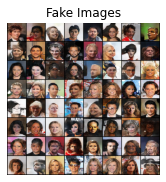

[9/15][800/1583]	Loss_D: 0.2389	Loss_G: 3.5542	D(x): 0.8971	D(G(z)): 0.1003 / 0.0491
[9/15][850/1583]	Loss_D: 0.1458	Loss_G: 4.3022	D(x): 0.9180	D(G(z)): 0.0491 / 0.0237
[9/15][900/1583]	Loss_D: 0.5995	Loss_G: 2.3540	D(x): 0.6575	D(G(z)): 0.0237 / 0.1876
[9/15][950/1583]	Loss_D: 0.4899	Loss_G: 5.5591	D(x): 0.9460	D(G(z)): 0.2895 / 0.0064
[9/15][1000/1583]	Loss_D: 0.1406	Loss_G: 3.9242	D(x): 0.9092	D(G(z)): 0.0360 / 0.0415
[9/15][1050/1583]	Loss_D: 0.2068	Loss_G: 4.0513	D(x): 0.8831	D(G(z)): 0.0612 / 0.0315
[9/15][1100/1583]	Loss_D: 0.1274	Loss_G: 3.6811	D(x): 0.9420	D(G(z)): 0.0559 / 0.0445
[9/15][1150/1583]	Loss_D: 0.1270	Loss_G: 4.6886	D(x): 0.9507	D(G(z)): 0.0623 / 0.0177
[9/15][1200/1583]	Loss_D: 1.2360	Loss_G: 3.0315	D(x): 0.8770	D(G(z)): 0.5763 / 0.0710
[9/15][1250/1583]	Loss_D: 0.3959	Loss_G: 4.4469	D(x): 0.9049	D(G(z)): 0.2155 / 0.0222


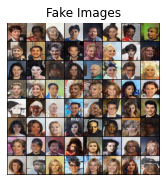

[9/15][1300/1583]	Loss_D: 0.3085	Loss_G: 4.6559	D(x): 0.9570	D(G(z)): 0.1940 / 0.0196
[9/15][1350/1583]	Loss_D: 0.2758	Loss_G: 4.3812	D(x): 0.9416	D(G(z)): 0.1692 / 0.0205
[9/15][1400/1583]	Loss_D: 0.1879	Loss_G: 3.1949	D(x): 0.8976	D(G(z)): 0.0645 / 0.0691
[9/15][1450/1583]	Loss_D: 0.2602	Loss_G: 3.3919	D(x): 0.8571	D(G(z)): 0.0741 / 0.0647
[9/15][1500/1583]	Loss_D: 0.3331	Loss_G: 3.8192	D(x): 0.8928	D(G(z)): 0.1614 / 0.0358
[9/15][1550/1583]	Loss_D: 0.2709	Loss_G: 3.2028	D(x): 0.8362	D(G(z)): 0.0561 / 0.0764


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[10/15][0/1583]	Loss_D: 0.1665	Loss_G: 3.7325	D(x): 0.8946	D(G(z)): 0.0465 / 0.0469
[10/15][50/1583]	Loss_D: 0.1184	Loss_G: 3.7808	D(x): 0.9223	D(G(z)): 0.0302 / 0.0426
[10/15][100/1583]	Loss_D: 0.1925	Loss_G: 4.6075	D(x): 0.9588	D(G(z)): 0.1241 / 0.0167
[10/15][150/1583]	Loss_D: 0.2323	Loss_G: 4.2951	D(x): 0.9215	D(G(z)): 0.1245 / 0.0223


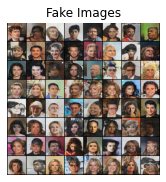

[10/15][200/1583]	Loss_D: 0.1126	Loss_G: 4.4536	D(x): 0.9148	D(G(z)): 0.0171 / 0.0239
[10/15][250/1583]	Loss_D: 2.7577	Loss_G: 4.4945	D(x): 0.9774	D(G(z)): 0.8702 / 0.0258
[10/15][300/1583]	Loss_D: 0.1851	Loss_G: 4.2554	D(x): 0.8928	D(G(z)): 0.0559 / 0.0265
[10/15][350/1583]	Loss_D: 0.1930	Loss_G: 3.7415	D(x): 0.9217	D(G(z)): 0.0926 / 0.0437
[10/15][400/1583]	Loss_D: 0.3708	Loss_G: 3.9573	D(x): 0.8617	D(G(z)): 0.1523 / 0.0327
[10/15][450/1583]	Loss_D: 0.4044	Loss_G: 2.8201	D(x): 0.7768	D(G(z)): 0.0807 / 0.1007
[10/15][500/1583]	Loss_D: 0.2496	Loss_G: 2.9980	D(x): 0.8703	D(G(z)): 0.0833 / 0.0845
[10/15][550/1583]	Loss_D: 0.2759	Loss_G: 2.3809	D(x): 0.8184	D(G(z)): 0.0375 / 0.1460
[10/15][600/1583]	Loss_D: 0.3091	Loss_G: 4.5069	D(x): 0.9176	D(G(z)): 0.1699 / 0.0206
[10/15][650/1583]	Loss_D: 0.0987	Loss_G: 4.3001	D(x): 0.9589	D(G(z)): 0.0489 / 0.0253


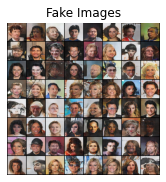

[10/15][700/1583]	Loss_D: 0.3971	Loss_G: 4.1934	D(x): 0.7559	D(G(z)): 0.0154 / 0.0329
[10/15][750/1583]	Loss_D: 0.8811	Loss_G: 2.8122	D(x): 0.7484	D(G(z)): 0.3267 / 0.1147
[10/15][800/1583]	Loss_D: 0.2759	Loss_G: 5.0051	D(x): 0.9189	D(G(z)): 0.1408 / 0.0120
[10/15][850/1583]	Loss_D: 0.1186	Loss_G: 5.1961	D(x): 0.9760	D(G(z)): 0.0789 / 0.0107
[10/15][900/1583]	Loss_D: 1.0344	Loss_G: 4.3500	D(x): 0.8921	D(G(z)): 0.5067 / 0.0226
[10/15][950/1583]	Loss_D: 1.1577	Loss_G: 6.2100	D(x): 0.9879	D(G(z)): 0.5691 / 0.0043
[10/15][1000/1583]	Loss_D: 0.2242	Loss_G: 3.6274	D(x): 0.9570	D(G(z)): 0.1320 / 0.0448
[10/15][1050/1583]	Loss_D: 0.2740	Loss_G: 3.4900	D(x): 0.8077	D(G(z)): 0.0239 / 0.0695
[10/15][1100/1583]	Loss_D: 0.2126	Loss_G: 3.5464	D(x): 0.8837	D(G(z)): 0.0551 / 0.0510
[10/15][1150/1583]	Loss_D: 0.2090	Loss_G: 3.4008	D(x): 0.8951	D(G(z)): 0.0656 / 0.0616


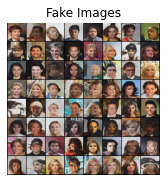

[10/15][1200/1583]	Loss_D: 0.3188	Loss_G: 3.1337	D(x): 0.7690	D(G(z)): 0.0114 / 0.0784
[10/15][1250/1583]	Loss_D: 0.1238	Loss_G: 4.1795	D(x): 0.9267	D(G(z)): 0.0376 / 0.0318
[10/15][1300/1583]	Loss_D: 0.1258	Loss_G: 3.6321	D(x): 0.9168	D(G(z)): 0.0277 / 0.0513
[10/15][1350/1583]	Loss_D: 1.9837	Loss_G: 4.9040	D(x): 0.7956	D(G(z)): 0.5876 / 0.0440
[10/15][1400/1583]	Loss_D: 0.3409	Loss_G: 3.4725	D(x): 0.8688	D(G(z)): 0.1404 / 0.0540
[10/15][1450/1583]	Loss_D: 0.4343	Loss_G: 1.6056	D(x): 0.7284	D(G(z)): 0.0434 / 0.2994
[10/15][1500/1583]	Loss_D: 0.1868	Loss_G: 3.5911	D(x): 0.9109	D(G(z)): 0.0697 / 0.0478
[10/15][1550/1583]	Loss_D: 0.2529	Loss_G: 4.1691	D(x): 0.9476	D(G(z)): 0.1579 / 0.0281


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[11/15][0/1583]	Loss_D: 0.1279	Loss_G: 4.0658	D(x): 0.9799	D(G(z)): 0.0936 / 0.0285
[11/15][50/1583]	Loss_D: 0.7762	Loss_G: 1.7595	D(x): 0.6305	D(G(z)): 0.1166 / 0.2437


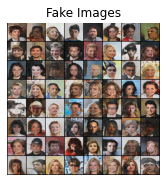

[11/15][100/1583]	Loss_D: 0.2764	Loss_G: 3.2910	D(x): 0.8072	D(G(z)): 0.0240 / 0.0786
[11/15][150/1583]	Loss_D: 0.1495	Loss_G: 4.8436	D(x): 0.9869	D(G(z)): 0.1147 / 0.0132
[11/15][200/1583]	Loss_D: 0.1068	Loss_G: 4.2590	D(x): 0.9509	D(G(z)): 0.0510 / 0.0251
[11/15][250/1583]	Loss_D: 0.0733	Loss_G: 4.2985	D(x): 0.9533	D(G(z)): 0.0213 / 0.0262
[11/15][300/1583]	Loss_D: 1.6731	Loss_G: 8.7337	D(x): 0.9970	D(G(z)): 0.6976 / 0.0005
[11/15][350/1583]	Loss_D: 0.5404	Loss_G: 7.7241	D(x): 0.9912	D(G(z)): 0.3402 / 0.0008
[11/15][400/1583]	Loss_D: 0.1397	Loss_G: 4.2316	D(x): 0.9218	D(G(z)): 0.0489 / 0.0281
[11/15][450/1583]	Loss_D: 0.1783	Loss_G: 5.1063	D(x): 0.9483	D(G(z)): 0.1028 / 0.0115
[11/15][500/1583]	Loss_D: 0.2827	Loss_G: 4.1360	D(x): 0.9291	D(G(z)): 0.1612 / 0.0244
[11/15][550/1583]	Loss_D: 4.9479	Loss_G: 0.1776	D(x): 0.0208	D(G(z)): 0.0019 / 0.8678


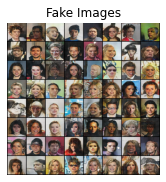

[11/15][600/1583]	Loss_D: 0.8984	Loss_G: 7.1367	D(x): 0.9972	D(G(z)): 0.4637 / 0.0020
[11/15][650/1583]	Loss_D: 0.1597	Loss_G: 4.0985	D(x): 0.9407	D(G(z)): 0.0856 / 0.0271
[11/15][700/1583]	Loss_D: 0.4459	Loss_G: 2.0476	D(x): 0.8174	D(G(z)): 0.1757 / 0.1913
[11/15][750/1583]	Loss_D: 0.1476	Loss_G: 3.6013	D(x): 0.9523	D(G(z)): 0.0849 / 0.0446
[11/15][800/1583]	Loss_D: 0.1448	Loss_G: 4.4316	D(x): 0.8959	D(G(z)): 0.0208 / 0.0255
[11/15][850/1583]	Loss_D: 0.1328	Loss_G: 4.1759	D(x): 0.9532	D(G(z)): 0.0732 / 0.0278
[11/15][900/1583]	Loss_D: 0.1153	Loss_G: 4.0457	D(x): 0.9520	D(G(z)): 0.0569 / 0.0328
[11/15][950/1583]	Loss_D: 0.0913	Loss_G: 4.6088	D(x): 0.9547	D(G(z)): 0.0410 / 0.0184
[11/15][1000/1583]	Loss_D: 0.1733	Loss_G: 3.6311	D(x): 0.8822	D(G(z)): 0.0332 / 0.0559
[11/15][1050/1583]	Loss_D: 0.1682	Loss_G: 3.9869	D(x): 0.9142	D(G(z)): 0.0614 / 0.0380


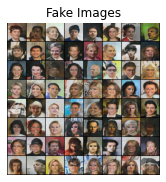

[11/15][1100/1583]	Loss_D: 0.2478	Loss_G: 2.5828	D(x): 0.8134	D(G(z)): 0.0118 / 0.1206
[11/15][1150/1583]	Loss_D: 0.0843	Loss_G: 4.4944	D(x): 0.9508	D(G(z)): 0.0290 / 0.0220
[11/15][1200/1583]	Loss_D: 0.3438	Loss_G: 3.0539	D(x): 0.8176	D(G(z)): 0.0498 / 0.0912
[11/15][1250/1583]	Loss_D: 0.9116	Loss_G: 2.0061	D(x): 0.5581	D(G(z)): 0.0637 / 0.2497
[11/15][1300/1583]	Loss_D: 0.2763	Loss_G: 3.7329	D(x): 0.8988	D(G(z)): 0.1257 / 0.0405
[11/15][1350/1583]	Loss_D: 0.4140	Loss_G: 3.6655	D(x): 0.7310	D(G(z)): 0.0268 / 0.0550
[11/15][1400/1583]	Loss_D: 0.2315	Loss_G: 4.6126	D(x): 0.9050	D(G(z)): 0.0992 / 0.0176
[11/15][1450/1583]	Loss_D: 0.3170	Loss_G: 2.2068	D(x): 0.7943	D(G(z)): 0.0392 / 0.1984
[11/15][1500/1583]	Loss_D: 0.4030	Loss_G: 2.8373	D(x): 0.7321	D(G(z)): 0.0211 / 0.1155
[11/15][1550/1583]	Loss_D: 0.2163	Loss_G: 4.0834	D(x): 0.9336	D(G(z)): 0.1186 / 0.0303


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[12/15][0/1583]	Loss_D: 0.1363	Loss_G: 4.5393	D(x): 0.9535	D(G(z)): 0.0765 / 0.0203


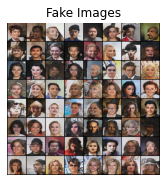

[12/15][50/1583]	Loss_D: 0.3562	Loss_G: 3.7866	D(x): 0.8144	D(G(z)): 0.0586 / 0.0453
[12/15][100/1583]	Loss_D: 0.1080	Loss_G: 4.9054	D(x): 0.9866	D(G(z)): 0.0841 / 0.0120
[12/15][150/1583]	Loss_D: 0.0794	Loss_G: 4.5453	D(x): 0.9652	D(G(z)): 0.0372 / 0.0226
[12/15][200/1583]	Loss_D: 0.7957	Loss_G: 6.5704	D(x): 0.9635	D(G(z)): 0.4335 / 0.0031
[12/15][250/1583]	Loss_D: 0.7892	Loss_G: 3.3482	D(x): 0.9505	D(G(z)): 0.4292 / 0.0640
[12/15][300/1583]	Loss_D: 0.3143	Loss_G: 1.9290	D(x): 0.8048	D(G(z)): 0.0607 / 0.2348
[12/15][350/1583]	Loss_D: 0.1501	Loss_G: 3.7622	D(x): 0.9190	D(G(z)): 0.0527 / 0.0435
[12/15][400/1583]	Loss_D: 1.1762	Loss_G: 1.5286	D(x): 0.5503	D(G(z)): 0.2530 / 0.3379
[12/15][450/1583]	Loss_D: 0.3820	Loss_G: 2.6800	D(x): 0.7624	D(G(z)): 0.0329 / 0.1265
[12/15][500/1583]	Loss_D: 0.1752	Loss_G: 4.2418	D(x): 0.9266	D(G(z)): 0.0795 / 0.0253


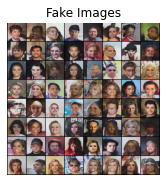

[12/15][550/1583]	Loss_D: 6.4633	Loss_G: 7.1118	D(x): 0.9994	D(G(z)): 0.9918 / 0.0021
[12/15][600/1583]	Loss_D: 0.2373	Loss_G: 3.2952	D(x): 0.8782	D(G(z)): 0.0744 / 0.0640
[12/15][650/1583]	Loss_D: 0.2736	Loss_G: 2.6542	D(x): 0.8623	D(G(z)): 0.0472 / 0.1193
[12/15][700/1583]	Loss_D: 0.1972	Loss_G: 4.6308	D(x): 0.9576	D(G(z)): 0.1261 / 0.0163
[12/15][750/1583]	Loss_D: 0.1202	Loss_G: 3.8548	D(x): 0.9661	D(G(z)): 0.0755 / 0.0411
[12/15][800/1583]	Loss_D: 0.9111	Loss_G: 3.8999	D(x): 0.7519	D(G(z)): 0.3509 / 0.0348
[12/15][850/1583]	Loss_D: 0.1081	Loss_G: 4.5681	D(x): 0.9401	D(G(z)): 0.0387 / 0.0189
[12/15][900/1583]	Loss_D: 0.1532	Loss_G: 4.0095	D(x): 0.9178	D(G(z)): 0.0469 / 0.0390
[12/15][950/1583]	Loss_D: 0.2532	Loss_G: 2.9096	D(x): 0.8258	D(G(z)): 0.0184 / 0.1043
[12/15][1000/1583]	Loss_D: 0.4672	Loss_G: 5.5125	D(x): 0.9780	D(G(z)): 0.2926 / 0.0078


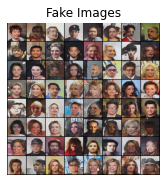

[12/15][1050/1583]	Loss_D: 0.5626	Loss_G: 2.6128	D(x): 0.6570	D(G(z)): 0.0086 / 0.1328
[12/15][1100/1583]	Loss_D: 0.1006	Loss_G: 4.3782	D(x): 0.9557	D(G(z)): 0.0484 / 0.0231
[12/15][1150/1583]	Loss_D: 0.1899	Loss_G: 3.6641	D(x): 0.9316	D(G(z)): 0.0673 / 0.0485
[12/15][1200/1583]	Loss_D: 0.3467	Loss_G: 1.9627	D(x): 0.7642	D(G(z)): 0.0162 / 0.2136
[12/15][1250/1583]	Loss_D: 0.1259	Loss_G: 3.6417	D(x): 0.9176	D(G(z)): 0.0213 / 0.0457
[12/15][1300/1583]	Loss_D: 0.0998	Loss_G: 4.9787	D(x): 0.9867	D(G(z)): 0.0761 / 0.0119
[12/15][1350/1583]	Loss_D: 1.0211	Loss_G: 1.8424	D(x): 0.6564	D(G(z)): 0.2759 / 0.2492
[12/15][1400/1583]	Loss_D: 0.1705	Loss_G: 4.0833	D(x): 0.9039	D(G(z)): 0.0418 / 0.0384
[12/15][1450/1583]	Loss_D: 0.1638	Loss_G: 5.3966	D(x): 0.9765	D(G(z)): 0.1153 / 0.0075
[12/15][1500/1583]	Loss_D: 0.0936	Loss_G: 4.7132	D(x): 0.9600	D(G(z)): 0.0433 / 0.0184


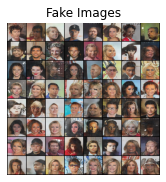

[12/15][1550/1583]	Loss_D: 1.3270	Loss_G: 7.7027	D(x): 0.9898	D(G(z)): 0.5987 / 0.0011


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[13/15][0/1583]	Loss_D: 1.2721	Loss_G: 2.0108	D(x): 0.4386	D(G(z)): 0.0511 / 0.2529
[13/15][50/1583]	Loss_D: 0.3489	Loss_G: 2.4923	D(x): 0.7754	D(G(z)): 0.0498 / 0.1397
[13/15][100/1583]	Loss_D: 0.1619	Loss_G: 5.0179	D(x): 0.9798	D(G(z)): 0.1202 / 0.0114
[13/15][150/1583]	Loss_D: 0.1060	Loss_G: 5.0135	D(x): 0.9810	D(G(z)): 0.0736 / 0.0127
[13/15][200/1583]	Loss_D: 0.1063	Loss_G: 4.9401	D(x): 0.9772	D(G(z)): 0.0748 / 0.0130
[13/15][250/1583]	Loss_D: 0.1257	Loss_G: 4.2460	D(x): 0.9364	D(G(z)): 0.0433 / 0.0287
[13/15][300/1583]	Loss_D: 0.0864	Loss_G: 5.3606	D(x): 0.9753	D(G(z)): 0.0531 / 0.0117
[13/15][350/1583]	Loss_D: 1.9892	Loss_G: 4.3252	D(x): 0.9439	D(G(z)): 0.7656 / 0.0326
[13/15][400/1583]	Loss_D: 0.1833	Loss_G: 3.7747	D(x): 0.9264	D(G(z)): 0.0811 / 0.0449


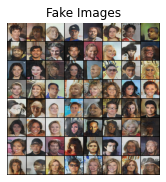

[13/15][450/1583]	Loss_D: 0.1456	Loss_G: 4.6317	D(x): 0.9448	D(G(z)): 0.0707 / 0.0219
[13/15][500/1583]	Loss_D: 0.7656	Loss_G: 1.6861	D(x): 0.5605	D(G(z)): 0.0067 / 0.2777
[13/15][550/1583]	Loss_D: 0.1331	Loss_G: 3.6883	D(x): 0.9349	D(G(z)): 0.0474 / 0.0631
[13/15][600/1583]	Loss_D: 2.9461	Loss_G: 0.9680	D(x): 0.1321	D(G(z)): 0.0014 / 0.5272
[13/15][650/1583]	Loss_D: 0.2355	Loss_G: 4.5827	D(x): 0.8367	D(G(z)): 0.0184 / 0.0275
[13/15][700/1583]	Loss_D: 0.1413	Loss_G: 3.8415	D(x): 0.9208	D(G(z)): 0.0432 / 0.0401
[13/15][750/1583]	Loss_D: 0.1696	Loss_G: 3.4341	D(x): 0.8847	D(G(z)): 0.0287 / 0.0629
[13/15][800/1583]	Loss_D: 0.4961	Loss_G: 5.3532	D(x): 0.9384	D(G(z)): 0.2947 / 0.0093
[13/15][850/1583]	Loss_D: 0.2261	Loss_G: 5.1533	D(x): 0.9803	D(G(z)): 0.1626 / 0.0091
[13/15][900/1583]	Loss_D: 0.2257	Loss_G: 3.7384	D(x): 0.8314	D(G(z)): 0.0050 / 0.0613


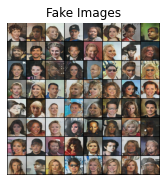

[13/15][950/1583]	Loss_D: 0.3164	Loss_G: 2.5892	D(x): 0.8198	D(G(z)): 0.0720 / 0.1488
[13/15][1000/1583]	Loss_D: 0.2484	Loss_G: 3.9464	D(x): 0.8593	D(G(z)): 0.0613 / 0.0375
[13/15][1050/1583]	Loss_D: 0.2029	Loss_G: 4.4210	D(x): 0.9488	D(G(z)): 0.1200 / 0.0273
[13/15][1100/1583]	Loss_D: 0.7029	Loss_G: 1.9783	D(x): 0.6841	D(G(z)): 0.1576 / 0.2149
[13/15][1150/1583]	Loss_D: 0.6525	Loss_G: 4.7232	D(x): 0.9435	D(G(z)): 0.3564 / 0.0193
[13/15][1200/1583]	Loss_D: 0.2150	Loss_G: 3.2575	D(x): 0.8482	D(G(z)): 0.0187 / 0.0979
[13/15][1250/1583]	Loss_D: 0.1149	Loss_G: 4.6991	D(x): 0.9452	D(G(z)): 0.0475 / 0.0210
[13/15][1300/1583]	Loss_D: 0.0662	Loss_G: 4.8990	D(x): 0.9695	D(G(z)): 0.0312 / 0.0148
[13/15][1350/1583]	Loss_D: 0.1831	Loss_G: 4.0729	D(x): 0.9454	D(G(z)): 0.1001 / 0.0334
[13/15][1400/1583]	Loss_D: 0.0571	Loss_G: 4.6069	D(x): 0.9813	D(G(z)): 0.0360 / 0.0192


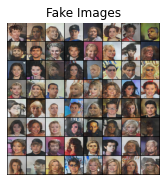

[13/15][1450/1583]	Loss_D: 0.0617	Loss_G: 4.9331	D(x): 0.9720	D(G(z)): 0.0299 / 0.0135
[13/15][1500/1583]	Loss_D: 0.8985	Loss_G: 9.2483	D(x): 0.9964	D(G(z)): 0.4803 / 0.0003
[13/15][1550/1583]	Loss_D: 0.1712	Loss_G: 4.8942	D(x): 0.9096	D(G(z)): 0.0550 / 0.0149


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[14/15][0/1583]	Loss_D: 0.3868	Loss_G: 2.8180	D(x): 0.7364	D(G(z)): 0.0036 / 0.1317
[14/15][50/1583]	Loss_D: 1.0473	Loss_G: 1.9023	D(x): 0.5798	D(G(z)): 0.1097 / 0.2599
[14/15][100/1583]	Loss_D: 0.3374	Loss_G: 4.2924	D(x): 0.9574	D(G(z)): 0.2143 / 0.0236
[14/15][150/1583]	Loss_D: 0.1775	Loss_G: 3.9655	D(x): 0.8793	D(G(z)): 0.0234 / 0.0374
[14/15][200/1583]	Loss_D: 0.1479	Loss_G: 5.8074	D(x): 0.9615	D(G(z)): 0.0823 / 0.0060
[14/15][250/1583]	Loss_D: 0.1065	Loss_G: 5.2366	D(x): 0.9781	D(G(z)): 0.0709 / 0.0113
[14/15][300/1583]	Loss_D: 0.1209	Loss_G: 4.0960	D(x): 0.9523	D(G(z)): 0.0588 / 0.0283


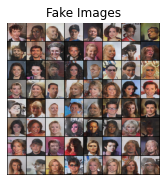

[14/15][350/1583]	Loss_D: 0.0907	Loss_G: 4.7274	D(x): 0.9577	D(G(z)): 0.0403 / 0.0195
[14/15][400/1583]	Loss_D: 0.0769	Loss_G: 4.6939	D(x): 0.9751	D(G(z)): 0.0482 / 0.0162
[14/15][450/1583]	Loss_D: 3.5360	Loss_G: 12.7598	D(x): 0.9947	D(G(z)): 0.9113 / 0.0000
[14/15][500/1583]	Loss_D: 0.3092	Loss_G: 3.5251	D(x): 0.8175	D(G(z)): 0.0617 / 0.0679
[14/15][550/1583]	Loss_D: 0.1238	Loss_G: 3.8501	D(x): 0.9433	D(G(z)): 0.0553 / 0.0407
[14/15][600/1583]	Loss_D: 1.3910	Loss_G: 3.7244	D(x): 0.8772	D(G(z)): 0.5874 / 0.0560
[14/15][650/1583]	Loss_D: 0.1764	Loss_G: 4.5304	D(x): 0.9373	D(G(z)): 0.0902 / 0.0216
[14/15][700/1583]	Loss_D: 0.3430	Loss_G: 3.3357	D(x): 0.7865	D(G(z)): 0.0507 / 0.0858
[14/15][750/1583]	Loss_D: 0.2378	Loss_G: 5.9767	D(x): 0.9804	D(G(z)): 0.1634 / 0.0045
[14/15][800/1583]	Loss_D: 0.1821	Loss_G: 4.0261	D(x): 0.9169	D(G(z)): 0.0739 / 0.0341


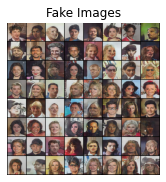

[14/15][850/1583]	Loss_D: 0.0747	Loss_G: 4.8660	D(x): 0.9647	D(G(z)): 0.0344 / 0.0169
[14/15][900/1583]	Loss_D: 0.4394	Loss_G: 3.3569	D(x): 0.7449	D(G(z)): 0.0312 / 0.0818
[14/15][950/1583]	Loss_D: 0.1120	Loss_G: 4.3936	D(x): 0.9428	D(G(z)): 0.0396 / 0.0272
[14/15][1000/1583]	Loss_D: 0.2376	Loss_G: 5.5391	D(x): 0.8736	D(G(z)): 0.0632 / 0.0099
[14/15][1050/1583]	Loss_D: 0.1093	Loss_G: 5.0346	D(x): 0.9873	D(G(z)): 0.0847 / 0.0115
[14/15][1100/1583]	Loss_D: 0.1466	Loss_G: 4.7760	D(x): 0.9714	D(G(z)): 0.0877 / 0.0201
[14/15][1150/1583]	Loss_D: 0.0896	Loss_G: 4.3300	D(x): 0.9607	D(G(z)): 0.0414 / 0.0252
[14/15][1200/1583]	Loss_D: 0.0959	Loss_G: 4.6466	D(x): 0.9385	D(G(z)): 0.0255 / 0.0225
[14/15][1250/1583]	Loss_D: 0.0431	Loss_G: 5.5159	D(x): 0.9817	D(G(z)): 0.0232 / 0.0089
[14/15][1300/1583]	Loss_D: 1.2344	Loss_G: 0.4958	D(x): 0.4037	D(G(z)): 0.0544 / 0.6862


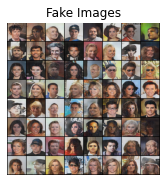

[14/15][1350/1583]	Loss_D: 0.7152	Loss_G: 9.2135	D(x): 0.9875	D(G(z)): 0.4011 / 0.0002
[14/15][1400/1583]	Loss_D: 0.4326	Loss_G: 8.4627	D(x): 0.9946	D(G(z)): 0.2748 / 0.0005
[14/15][1450/1583]	Loss_D: 0.3130	Loss_G: 7.0182	D(x): 0.9930	D(G(z)): 0.2335 / 0.0014
[14/15][1500/1583]	Loss_D: 0.7075	Loss_G: 2.1782	D(x): 0.6626	D(G(z)): 0.1116 / 0.1796
[14/15][1550/1583]	Loss_D: 0.1793	Loss_G: 3.4415	D(x): 0.8913	D(G(z)): 0.0306 / 0.0654


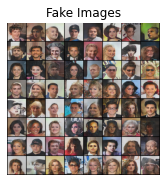

In [ ]:
# Number of training epochs
num_epochs = 15

# Learning rate for optimizers
lr = 0.0005

# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            # Plot the fake images from the last epoch
            plt.subplot(1,2,2)
            plt.axis("off")
            plt.title("Fake Images")
            plt.imshow(np.transpose(img_list[-1],(1,2,0)))
            plt.show()

        iters += 1

torch.save(netG.state_dict(), f'{data_dirs}/output/gen_model.pth')

## Plot

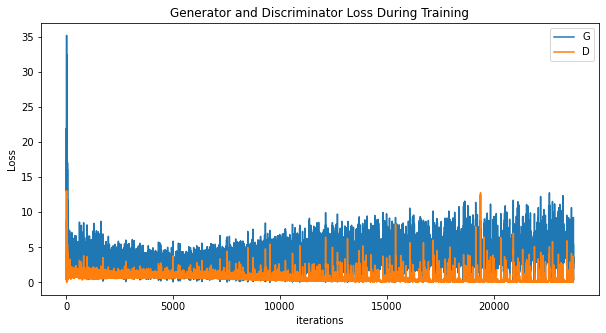

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21176234 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


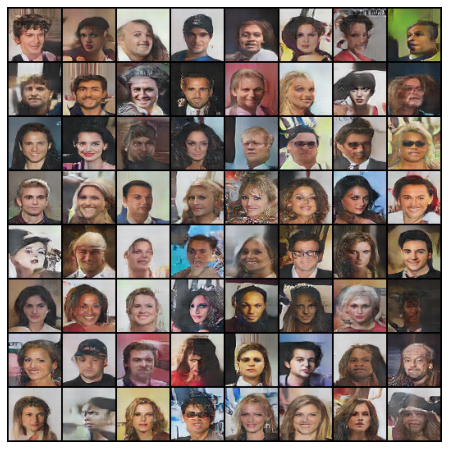

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Results

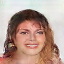

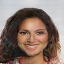

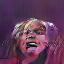

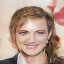

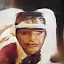

...

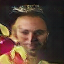

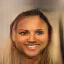

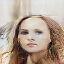

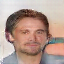

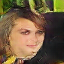

'\n# Grab a batch of real images from the dataloader\nreal_batch = next(iter(dataloader))\n\n# Plot the real images\nplt.figure(figsize=(15,15))\nplt.subplot(1,2,1)\nplt.axis("off")\nplt.title("Real Images")\nplt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))\n\n# Plot the fake images from the last epoch\nplt.subplot(1,2,2)\nplt.axis("off")\nplt.title("Fake Images")\nplt.imshow(np.transpose(img_list[-1],(1,2,0)))\nplt.show()\n'

In [ ]:
# Load the generator
# netG = Generator(ngpu).to(device)
model = Generator(ngpu).cuda()
model.load_state_dict(torch.load(f'{data_dirs}/output/gen_model.pth'))
model = model.eval() # changing the model to evaluation mode will fix the bachnorm layers

# Generate batch of latent vectors
noise = torch.randn(128, nz, 1, 1, device='cuda:0')
# Generate fake image batch with G
fake = model(noise)

# pred_mask[0].detach().cpu().squeeze().numpy()

for i in range(len(fake)):
  im = fake[i].detach().cpu().permute(1, 2, 0).numpy()
  rgb = cv2.cvtColor(im, cv2.COLOR_BGR2RGB) * 255
  rgb = cv2.normalize(src=rgb, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
  cv2_imshow(rgb)
  cv2.imwrite(f'{data_dirs}/output/fakes/fake_{i}.png', rgb)

'''
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()
'''